<a href="https://colab.research.google.com/github/fazatra/PCVK_Genap_2023/blob/master/week7.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# PRAKTIKUM

In [ ]:
from google.colab import drive

# Accessing My Google Drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import cv2 as cv
import math
from google.colab.patches import cv2_imshow
from PIL import Image as im

In [ ]:
def convolution2d(image, kernel, stride, padding):

  image = np.pad(image, padding, mode='constant', constant_values=0)

  kernel_height, kernel_width = kernel.shape
  padded_height, padded_width = image.shape

  output_height = (padded_height - kernel_height) // stride + 1
  output_width = (padded_width - kernel_width) // stride + 1

  new_image = np.zeros((output_height, output_width)).astype(np.float32)

  # convolution process
  for y in range(0, output_height):
    for x in range(0, output_width):
      new_image[y][x] = np.sum(image[y * stride:y * stride + kernel_height, x * stride:x * stride + kernel_width] * kernel).astype(np.float32)

  return new_image

In [ ]:
img_m = cv.imread('/content/drive/MyDrive/PCVK/Images/female.tiff')
img_s = cv.resize(img_m, (0,0), fx=0.5, fy=0.5)
img_gray = cv.cvtColor(img_m, cv.COLOR_BGR2GRAY)

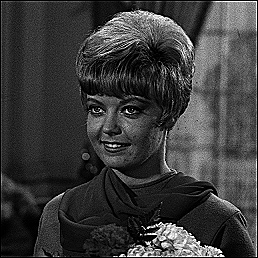

In [ ]:
# SHARPEN

kernel_sharpen = np.array([[0, -1, 0],
                           [-1, 5, -1],
                           [0, -1, 0]])
cv2_imshow(convolution2d(img_gray, kernel_sharpen, 1, 2))

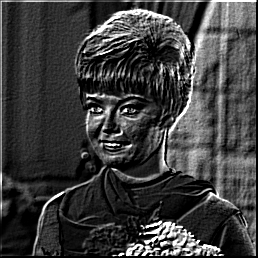

In [ ]:
# EMBOS

kernel_embos = np.array([[-2, -1, 0],
                           [-1, 1, 1],
                           [0, 1, 2]])
cv2_imshow(convolution2d(img_gray, kernel_embos, 1, 2))

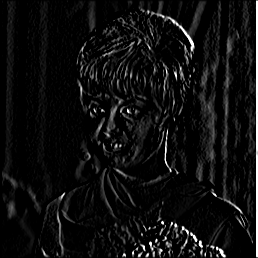

In [ ]:
# Left Sobel Edge Detection

kernel_sobel = np.array([[1, 0, -1],
                           [2, 0, -2],
                           [1, 0, -1]])
cv2_imshow(convolution2d(img_gray, kernel_sobel, 1, 2))

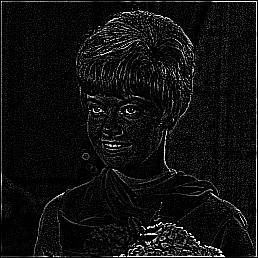

In [ ]:
# Canny edge Detection

kernel_edge = np.array([[-1, -1, -1],
                           [-1, 8, -1],
                           [-1, -1, -1]])
cv2_imshow(convolution2d(img_gray, kernel_edge, 1, 2))

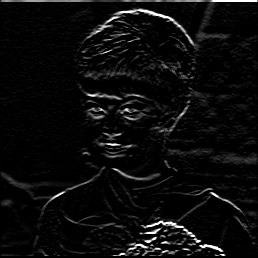

In [ ]:
# Prewitt Edge Detection
kernel_prewitt= np.array([[-1, -1, -1],
                             [0, 0, 0],
                             [1, 1, 1]])
cv2_imshow(convolution2d(img_gray, kernel_prewitt, 1, 2))

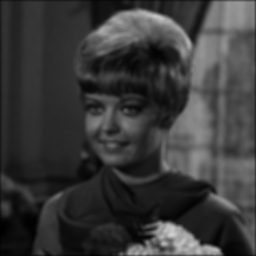

In [ ]:
# 5x5 Gaussian Blur

kernel_size = 5
sigma = math.sqrt(kernel_size)
gaussian_kernel = cv.getGaussianKernel(kernel_size, sigma)
kernel_gauss= gaussian_kernel @ gaussian_kernel.transpose()

cv2_imshow(convolution2d(img_gray, kernel_gauss, 1, 2))

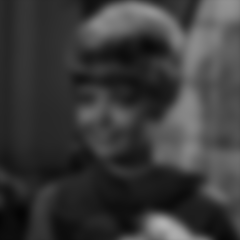

In [ ]:
# 21x21 Gaussian Blur

kernel_size = 21
sigma = math.sqrt(kernel_size)
gaussian_kernel = cv.getGaussianKernel(kernel_size, sigma)
gauss_kernel = gaussian_kernel @ gaussian_kernel.transpose()

cv2_imshow(convolution2d(img_gray, gauss_kernel, 1, 2))

# TUGAS

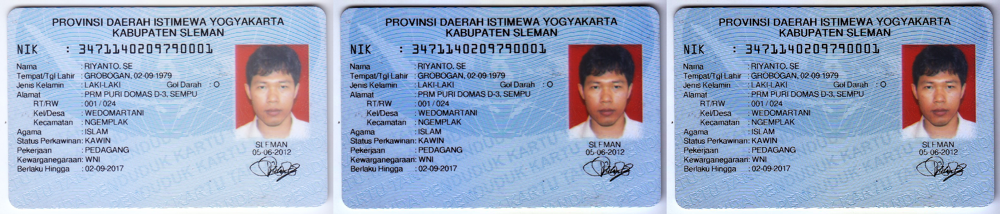

In [ ]:
def gamma_correction(image, gamma):
  inv_gamma = 1 / gamma
  gamma_image = np.zeros(image.shape, image.dtype)

  # Akses per pixel
  for y in range(image.shape[0]):
    for x in range(image.shape[1]):
      for c in range(image.shape[2]):
        gamma_image[y, x, c] = np.clip((image[y, x, c] / 255) ** inv_gamma * 255, 0, 255)

  return gamma_image

def hitung_pixel(image):
  red = {}
  green = {}
  blue = {}

  # Akses per pixel
  for y in range(image.shape[0]):
    for x in range(image.shape[1]):
      b = int(image[y, x, 0])
      g = int(image[y, x, 1])
      r = int(image[y, x, 2])

      if r in red:
        red[r] += 1
      else:
        red[r] = 1

      if g in green:
        green[g] += 1
      else:
        green[g] = 1

      if b in blue:
        blue[b] += 1
      else:
        blue[b] = 1

  return red, green, blue

def histogram_equalization(image):

  # Intensitas Pixel
  intensitas_merah, intensitas_hijau, intensitas_biru = hitung_pixel(image)

  red_channel = hitung_sk(image[...,2], intensitas_merah)
  green_channel = hitung_sk(image[...,1], intensitas_hijau)
  blue_channel = hitung_sk(image[...,0], intensitas_biru)

  merged_image = cv.merge([blue_channel, green_channel, red_channel])

  return merged_image

def hitung_sk(image, list_intensitas):
  list_intensitas = dict(sorted(list_intensitas.items()))

  # l, rj dan nrj
  l = 256
  rj = list(list_intensitas.keys())
  nrj = list(list_intensitas.values())

  # K0
  k0 = []
  for i in range(len(rj)):
    if i == 0:
      k0.append(nrj[i])
    else:
      k0.append(nrj[i] + k0[i - 1])

  # Sk = round((L-1)/MAX(k0) * k0)
  sk = []
  list_pixel_baru = {}
  for i in range(len(rj)):
    k0s = (l - 1) / k0[-1] * k0[i]
    sk.append(round(k0s))

    list_pixel_baru[rj[i]] = sk[i]

  # Konversi nilai pixel
  for y in range(image.shape[0]):
    for x in range(image.shape[1]):
      image[y, x] = list_pixel_baru[image[y, x]]

  return image

kernel_sharpen = np.array([[0, -1, 0],
                          [-1, 5, -1],
                          [0, -1, 0]], dtype=np.float32)

unsharp_masking_5_x_5 = np.array([[1, 4, 6, 4, 1],
                                [4, 16, 24, 16, 4],
                                [6, 24, -476, 24, 6],
                                [4, 16, 24, 16, 4],
                                [1, 4, 6, 4, 1]], dtype=np.float32)

unsharp_masking_5_x_5 = unsharp_masking_5_x_5 * -1 / 256

def convolution2d(image, kernel):
    return cv.filter2D(image, -1, kernel)

# ...

ktp = cv.imread('/content/drive/MyDrive/PCVK/Images/KTP_More/ktp.png')
ktp_copy = np.copy(ktp)
ktp_result = gamma_correction(ktp_copy, 0.5)
ktp_filtered = convolution2d(ktp_result, unsharp_masking_5_x_5)

final_frame = cv.hconcat((ktp, ktp_result, ktp_filtered))
cv2_imshow(final_frame)

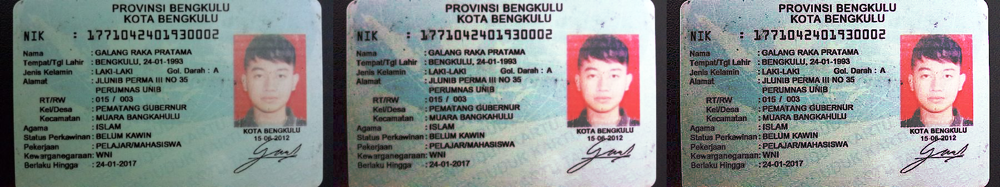

In [ ]:
ktp1 = cv.imread('/content/drive/MyDrive/PCVK/Images/KTP_More/ktp1.png')
ktp1_copy = np.copy(ktp1)
ktp1_result = histogram_equalization(ktp1_copy)
ktp1_result = gamma_correction(ktp1_result, 1.4)
ktp1_filtered = convolution2d(ktp1_result, kernel_sharpen)

final_frame = cv.hconcat((ktp1, ktp1_result, ktp1_filtered))
cv2_imshow(final_frame)

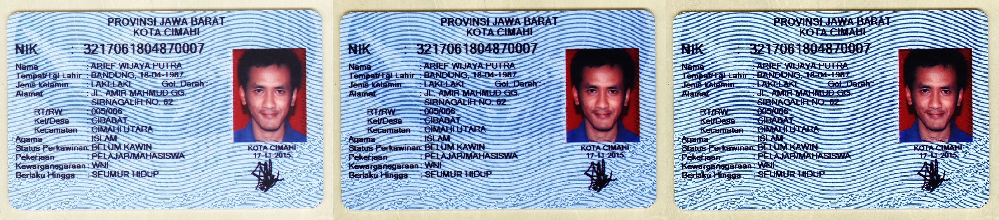

In [ ]:
ktp2 = cv.imread('/content/drive/MyDrive/PCVK/Images/KTP_More/ktp2.png')
ktp2_copy = np.copy(ktp2)
ktp2_result = gamma_correction(ktp2_copy, 0.6)
ktp2_filtered = convolution2d(ktp2_result, unsharp_masking_5_x_5)

final_frame = cv.hconcat((ktp2, ktp2_result, ktp2_filtered))
cv2_imshow(final_frame)

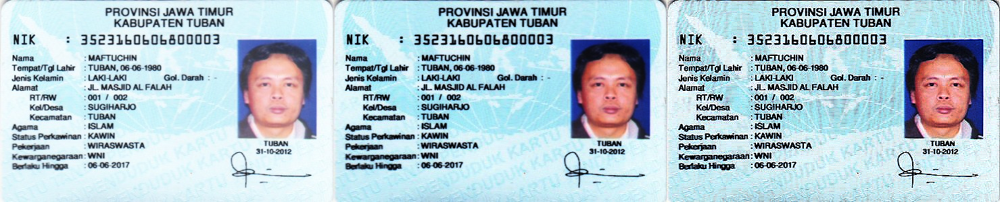

In [ ]:
ktp3 = cv.imread('/content/drive/MyDrive/PCVK/Images/KTP_More/ktp3.png')
ktp3_copy = np.copy(ktp3)
ktp3_result = gamma_correction(ktp3_copy, 0.5)
ktp3_filtered = convolution2d(ktp3_result, kernel_sharpen)

final_frame = cv.hconcat((ktp3, ktp3_result, ktp3_filtered))
cv2_imshow(final_frame)

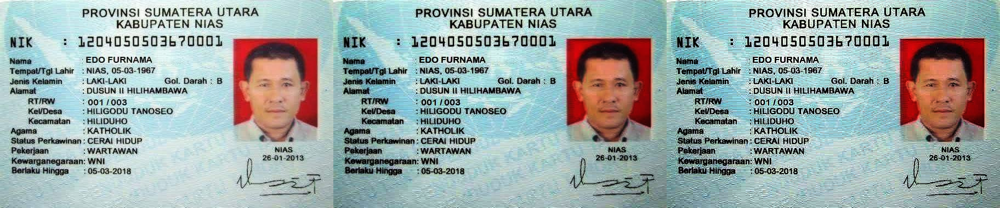

In [ ]:
unsharp_masking_5_x_5 = np.array([[1, 4, 6, 4, 1],
                                [4, 16, 24, 16, 4],
                                [6, 24, -476, 24, 6],
                                [4, 16, 24, 16, 4],
                                [1, 4, 6, 4, 1]], dtype=np.float32)

unsharp_masking_5_x_5 = unsharp_masking_5_x_5 * -1 / 256

ktp5 = cv.imread('/content/drive/MyDrive/PCVK/Images/KTP_More/ktp5.png')
ktp5_copy = np.copy(ktp5)
ktp5_result = gamma_correction(ktp5_copy, 0.6)
ktp5_filtered = convolution2d(ktp5_result, unsharp_masking_5_x_5)

final_frame = cv.hconcat((ktp5, ktp5_result, ktp5_filtered))
cv2_imshow(final_frame)

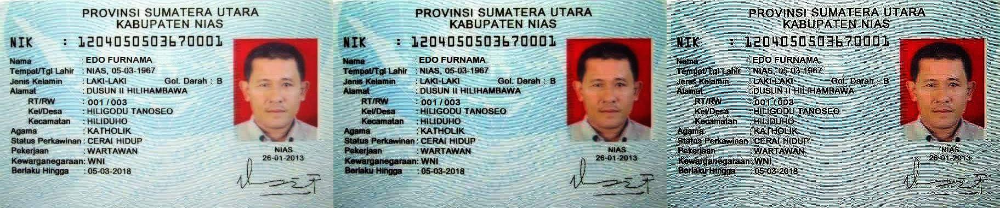

In [ ]:
ktp5 = cv.imread('/content/drive/MyDrive/PCVK/Images/KTP_More/ktp5.png')
ktp5_copy = np.copy(ktp5)
ktp5_result = gamma_correction(ktp5_copy, 0.6)
ktp5_filtered = convolution2d(ktp5_result, kernel_sharpen)

final_frame = cv.hconcat((ktp5, ktp5_result, ktp5_filtered))
cv2_imshow(final_frame)

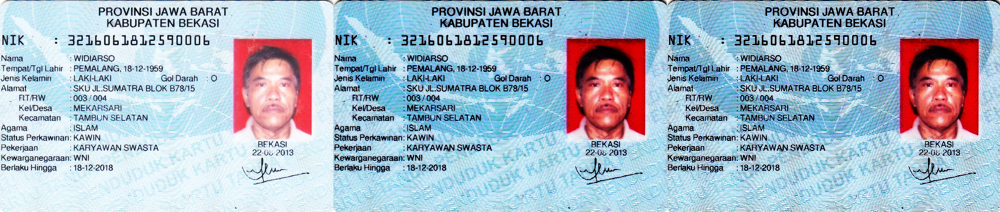

In [ ]:
ktp6 = cv.imread('/content/drive/MyDrive/PCVK/Images/KTP_More/ktp6.png')
ktp6_copy = np.copy(ktp6)
ktp6_result = gamma_correction(ktp6_copy, 0.3)
ktp6_filtered = convolution2d(ktp6_result, unsharp_masking_5_x_5)

final_frame = cv.hconcat((ktp6, ktp6_result, ktp6_filtered))
cv2_imshow(final_frame)

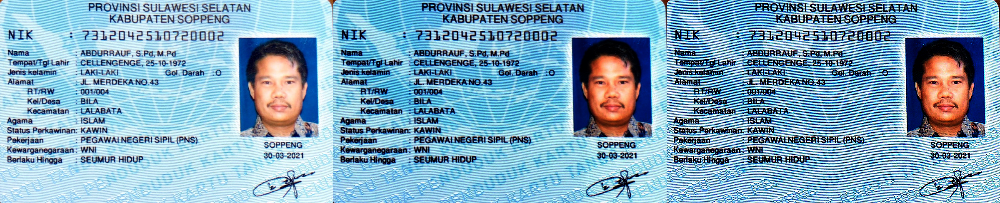

In [ ]:
ktp7 = cv.imread('/content/drive/MyDrive/PCVK/Images/KTP_More/KTP7.jpeg')
ktp7_copy = np.copy(ktp7)
ktp7_result = gamma_correction(ktp7_copy, 0.48)
ktp7_filtered = convolution2d(ktp7_result, kernel_sharpen)

final_frame = cv.hconcat((ktp7, ktp7_result, ktp7_filtered))
cv2_imshow(final_frame)